In [2]:
from email.mime import image
import sys
import pandas as pd
sys.path.append('/home/pc575/rds/rds-kzfps-XrHDlpCeVDg/users/pakkanan/phd_project_development/dev/packaging_dir/ma_mapper/')
from ma_mapper import extract_bigwig
from ma_mapper import extract_bam
from ma_mapper import mapper

In [3]:
subfamily = ['THE1C']
alignment_file = '/home/pc575/rds/rds-kzfps-XrHDlpCeVDg/users/pakkanan/phd_project_development/data/_mapper_output/hg38_repeatmasker_4_0_5_repeatlib20140131/old_result_redo/alignment/'+subfamily[0]+'.fasta.aligned'
alignment_filtered, metadata_filtered= mapper.parse_and_filter(alignment_file)
metadata_age = mapper.match_age_to_id_metadata(metadata_filtered)

2024-05-15 06:45:13,645 INFO: parse alignment


In [4]:
coord_file = '/home/pc575/rds/rds-mi339-kzfps/users/pakkanan/phd_project_development/data/_mapper_output/hg38_repeatmasker_4_0_5_repeatlib20140131/old_result_redo/coord_internal_id/'+subfamily[0]+'.txt'

In [5]:
bam_file = '/home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/KZFP-bam_hg38/znf267.sorted.bam'
bam_forward=mapper.map_and_overlay(alignment_file, coord_file, bam_file, data_format='read_forward')
bam_reverse=mapper.map_and_overlay(alignment_file, coord_file, bam_file, data_format='read_reverse')
bam_min=mapper.map_and_overlay(alignment_file, coord_file, bam_file, data_format='read_min')

2024-05-15 06:45:25,991 INFO: parse alignment
2024-05-15 06:45:35,625 INFO: done, returning mapped bam as a list. format: read_forward
2024-05-15 06:45:44,020 INFO: parse alignment
2024-05-15 06:45:53,585 INFO: done, returning mapped bam as a list. format: read_reverse
2024-05-15 06:46:01,894 INFO: parse alignment
2024-05-15 06:46:11,573 INFO: done, returning mapped bam as a list. format: read_min


In [6]:
bigwig_file = '/home/pc575/rds/rds-kzfps-XrHDlpCeVDg/users/pakkanan/phd_project_development/data/hg38_bigwig/241-mammalian-2020v2.bigWig'
phylop=mapper.map_and_overlay(alignment_file, coord_file, bigwig_file, data_format='bigwig')

2024-05-15 06:46:20,059 INFO: parse alignment
2024-05-15 06:46:28,058 INFO: done, returning bigwig_out as object


In [7]:
bed_file = '/home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/AP-1(bZIP).bed'
ap1=mapper.map_and_overlay(alignment_file, coord_file, bed_file, data_format='bed')
bed_file = '/home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/NFkB-p65.bed'
nfkb=mapper.map_and_overlay(alignment_file, coord_file, bed_file, data_format='bed')
bed_file = '/home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/BMAL1.bed'
bmal=mapper.map_and_overlay(alignment_file, coord_file, bed_file, data_format='bed')
bed_file = '/home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/CLOCK.bed'
clock=mapper.map_and_overlay(alignment_file, coord_file, bed_file, data_format='bed')

2024-05-15 06:46:36,548 INFO: parse alignment
2024-05-15 06:46:41,963 INFO: extract from bam file: /home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/AP-1(bZIP).bed
2024-05-15 06:47:03,342 INFO: done, returning bed_out as object
2024-05-15 06:47:12,063 INFO: parse alignment
2024-05-15 06:47:17,160 INFO: extract from bam file: /home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/NFkB-p65.bed
2024-05-15 06:47:39,722 INFO: done, returning bed_out as object
2024-05-15 06:47:48,133 INFO: parse alignment
2024-05-15 06:47:53,229 INFO: extract from bam file: /home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/BMAL1.bed
2024-05-15 06:48:22,443 INFO: done, returning bed_out as object
2024-05-15 06:48:30,786 INFO: parse alignment
2024-05-15 06:48:35,897 INFO: extract from bam file: /home/pc575/rds/rds-mi339-kzfps/users/pakkanan/_housekeeping/data/tfbs_homer/CLOCK.bed
2024-05-15 06:48:55,095 INFO: done, returning bed_out as

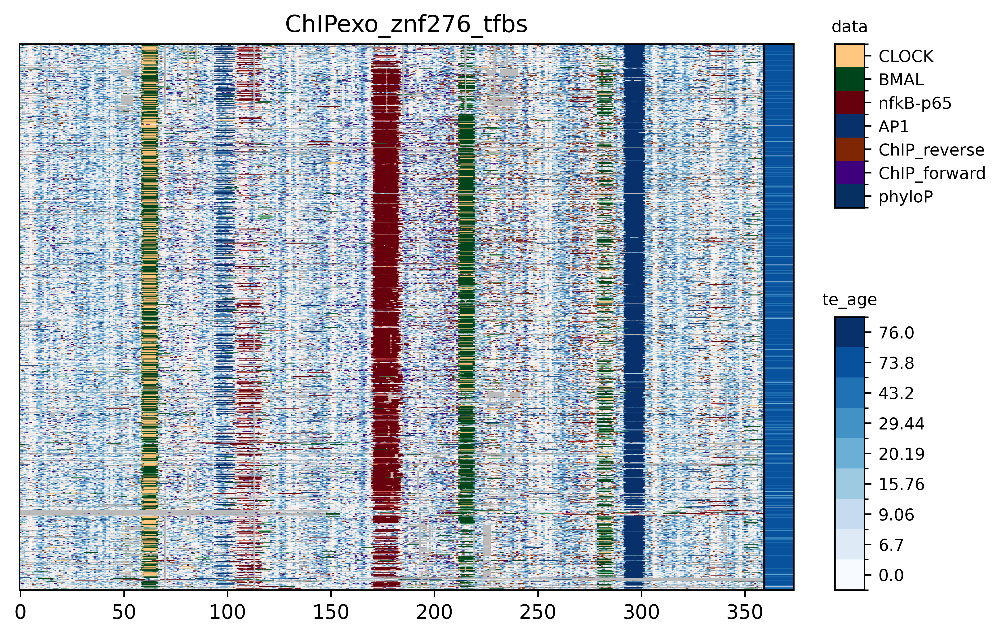

In [8]:
from ma_mapper import plot
plot.overlay_plot([alignment_filtered,phylop,bam_forward, bam_reverse,ap1,nfkb,bmal,clock], metadata= metadata_age, nucleotide_color='white',data_vmin=[-0.5,0,0,0,0,0,0],data_vmax = [0.5,0.1,0.1,1,1,1,1],data_cmap=['RdBu','Purples','Oranges','Blues','Reds','Greens','copper'], plot_title='ChIPexo_znf276_tfbs', show_data_legend=True,data_label=['phyloP','ChIP_forward','ChIP_reverse','AP1','nfkB-p65','BMAL','CLOCK'])

In [9]:
from matplotlib.colors import ListedColormap, BoundaryNorm
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
if sys.version_info >= (3, 8, 0):
    from typing import Literal, Tuple, List
else:
    from typing_extensions import Literal, Tuple, List

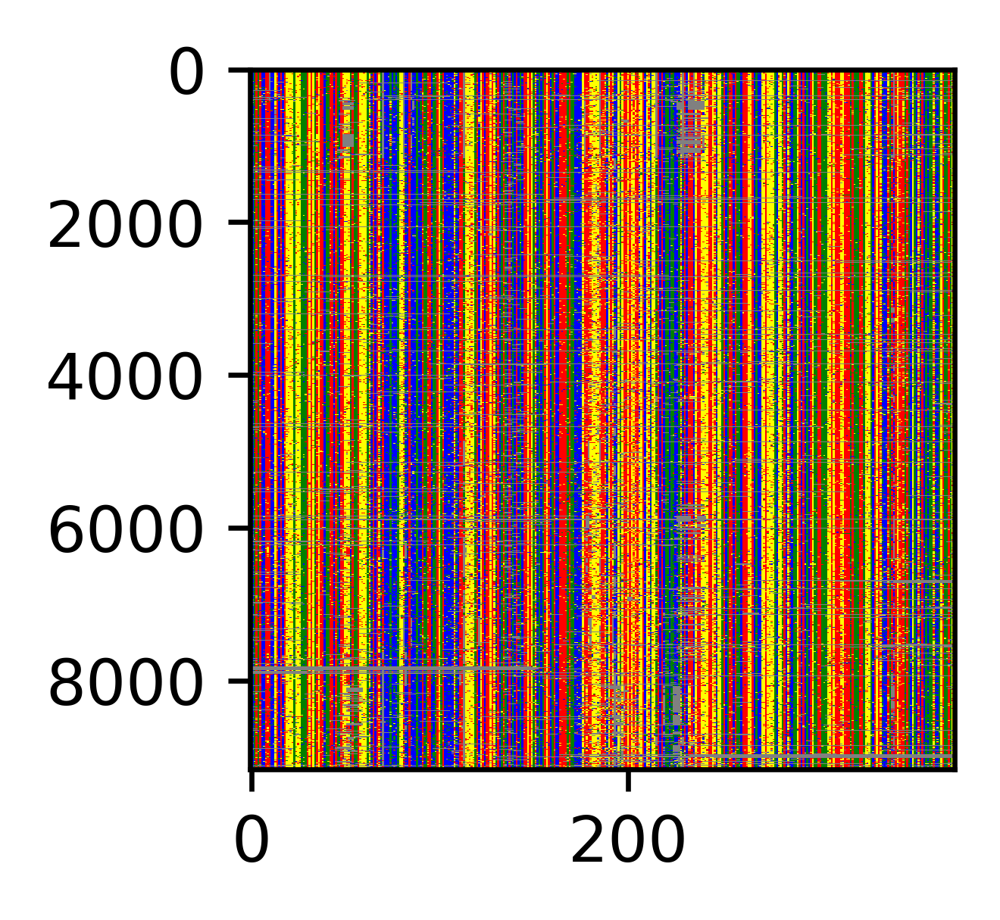

In [10]:
fig, ax = plt.subplots(figsize=(2,2))
nucleotide_labels = ['gap', 'A', 'C', 'T', 'G']
nucleotide_color_list = ['grey','green','yellow','red','blue']
align_cmap = ListedColormap(nucleotide_color_list)

#align_cmap =ListedColormap(['grey','white','white','white','white'])
ax.set_alpha(0.5)
heatmap = ax.imshow(alignment_filtered, aspect = 'auto',cmap= align_cmap, interpolation='nearest', vmin=0,vmax=5)

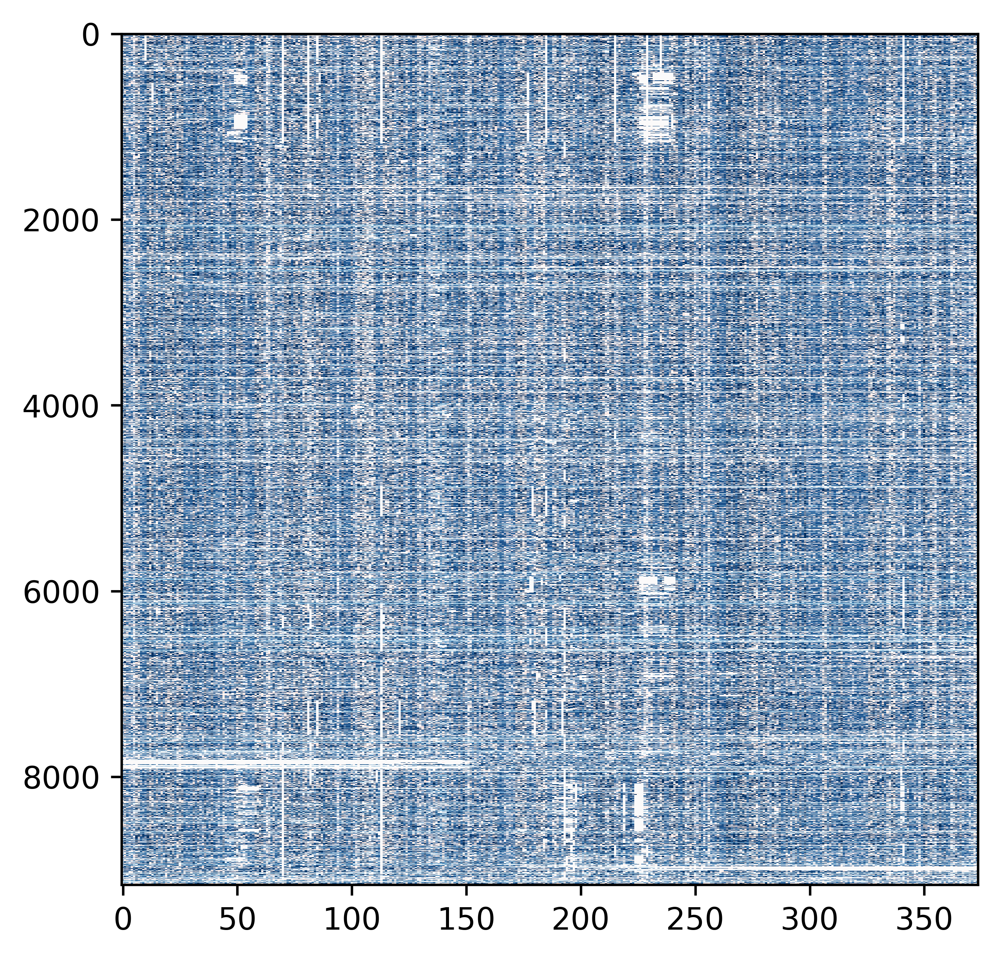

In [11]:
fig, ax = plt.subplots(figsize=(5,5))
data_cmap = ['RdBu']
ncolors = 256
overlay_color = data_cmap[0]
overlay_cmap = plt.get_cmap(overlay_color)(range(ncolors))
overlay_cmap[:,-1] = np.linspace(0,1.0,ncolors)
overlay_cmap_alpha = ListedColormap(colors=overlay_cmap)
heatmap = ax.imshow(phylop,aspect='auto',cmap= overlay_cmap_alpha, interpolation='nearest', vmax=0.5, vmin=-0.5)

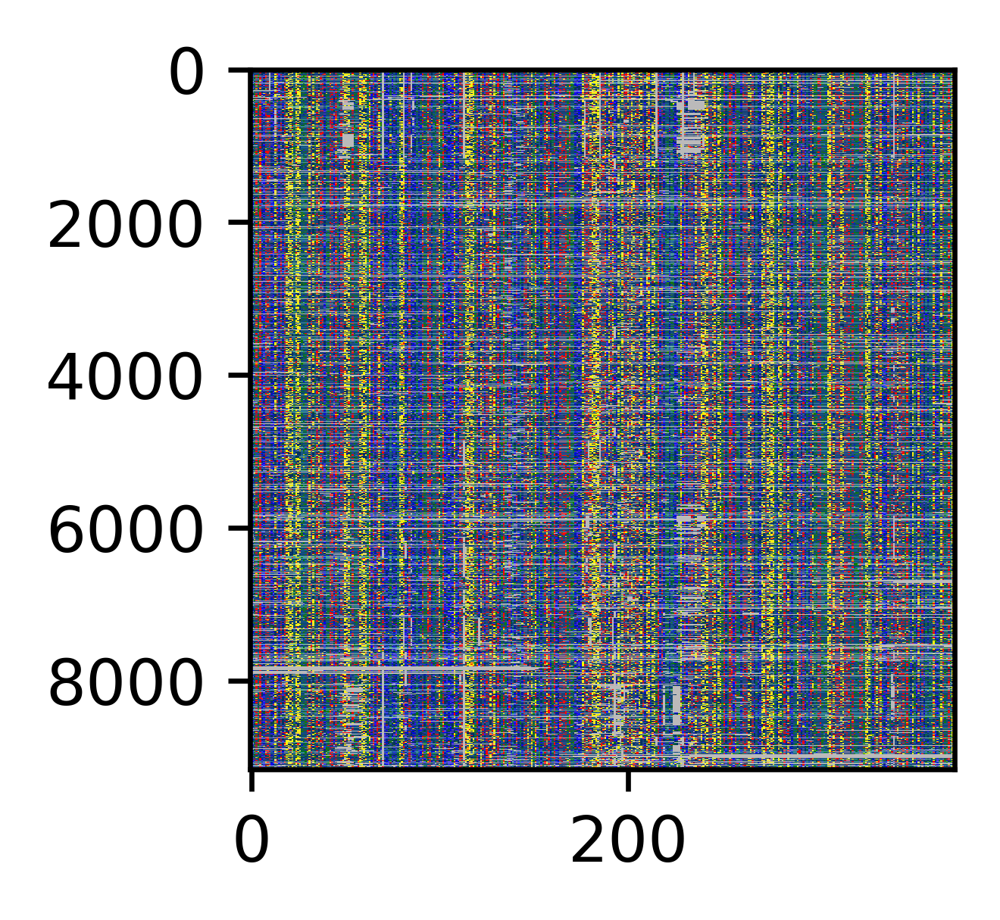

In [12]:
fig, ax = plt.subplots(figsize=(2,2))
ax.set_alpha(0.1)
heatmap = ax.imshow(alignment_filtered, aspect = 'auto',cmap= align_cmap, interpolation='nearest', vmin=0,vmax=5)
ax.set_alpha(0.9)
heatmap = ax.imshow(phylop,aspect='auto',cmap= overlay_cmap_alpha, interpolation='nearest', vmax=0.5, vmin=-0.5)

In [13]:
def plot_heatmap(data: List|np.ndarray|None = None,
                 save_to_file: bool = False,
                 output_filepath: str | None = None, 
                 image_res: int = 600, 
                 cmap: ListedColormap|str|None = None,
                 plot_title: str|None = None,
                 xlim: List|None = None,
                 ylim: List|None = None,
                 figsize:List=[2,2],
                 opacity: float = 1.0,
                 show_plot:bool = False, 
                 matplot_axes = None,
                 **kwargs):
    if isinstance(cmap, ListedColormap):
        plot_cmap_a = cmap
    else:
        if cmap in ['nulc_white', 'dna']:
            if cmap == 'nulc_white':
                plot_cmap = ListedColormap(['grey','white'])
            else:
                nucleotide_color_list = ['grey','green','yellow','red','blue']
            plot_cmap = ListedColormap(nucleotide_color_list)
            kwargs['vmax'] = 5
            kwargs['vmin'] = 0
        else:
            print(cmap)
            if cmap is None:
                cmap = 'Blues'
            ncolors = 256
            plot_cmap = plt.get_cmap(cmap)(range(ncolors))
            plot_cmap[:,-1] = np.linspace(0,opacity,ncolors)
            plot_cmap_a = ListedColormap(colors=plot_cmap)
    if matplot_axes is not None:
        heatmap = matplot_axes.imshow(data, aspect= 'auto', cmap=plot_cmap_a,**kwargs)
    else:
        fig, ax = plt.subplots(figsize=(figsize[0],figsize[1]))
        heatmap = ax.imshow(data, aspect='auto', cmap=plot_cmap_a,**kwargs)
        if plot_title is not None:
            ax.set_title(plot_title)
        if xlim is not None:
            ax.set_xlim(xlim[0],xlim[1])
        if ylim is not None:
            ax.set_ylim(ylim[0],ylim[1])
        if show_plot == True:
            plt.rcParams['savefig.dpi'] = image_res
            plt.show()
        if save_to_file == True:
            if output_filepath is None:
                output_filepath = f'{os.path.dirname(os.path.abspath(__file__))}/overlay.png'
            fig.write_image(output_filepath)

RdBu


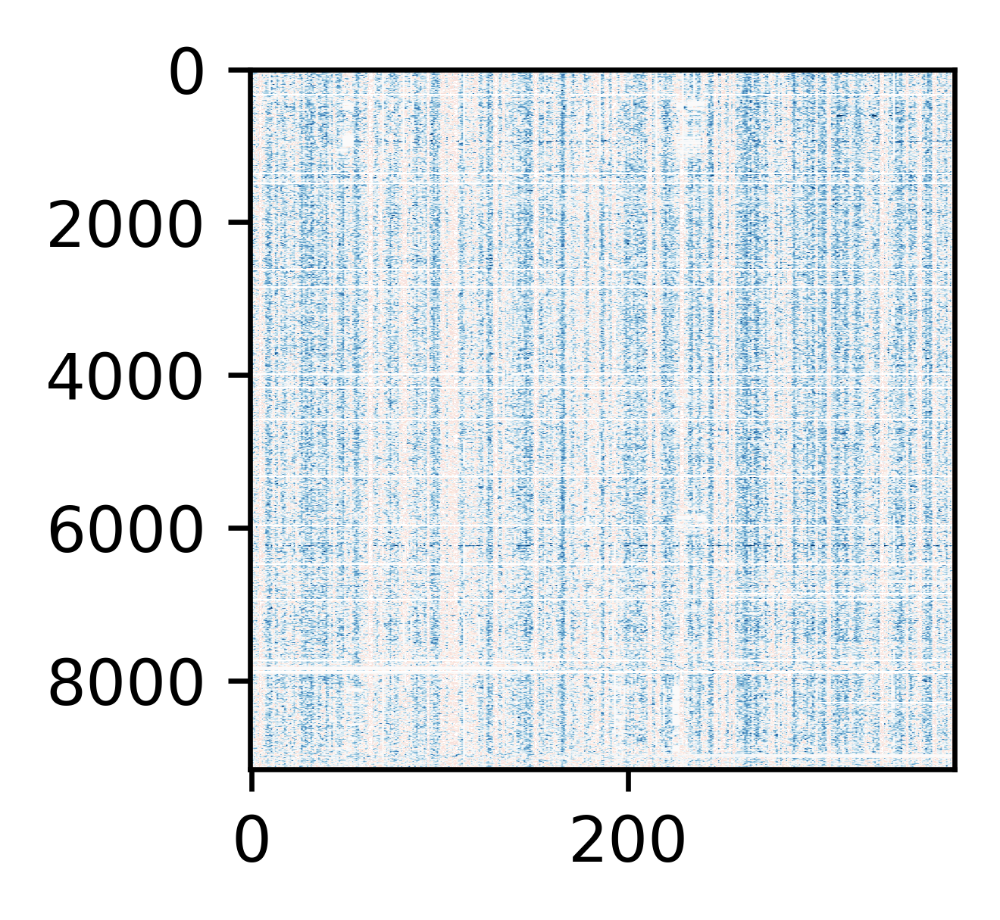

In [14]:
plot_heatmap(phylop, cmap='RdBu', image_res=100, vmax=0.5,vmin=-0.5)

RdBu


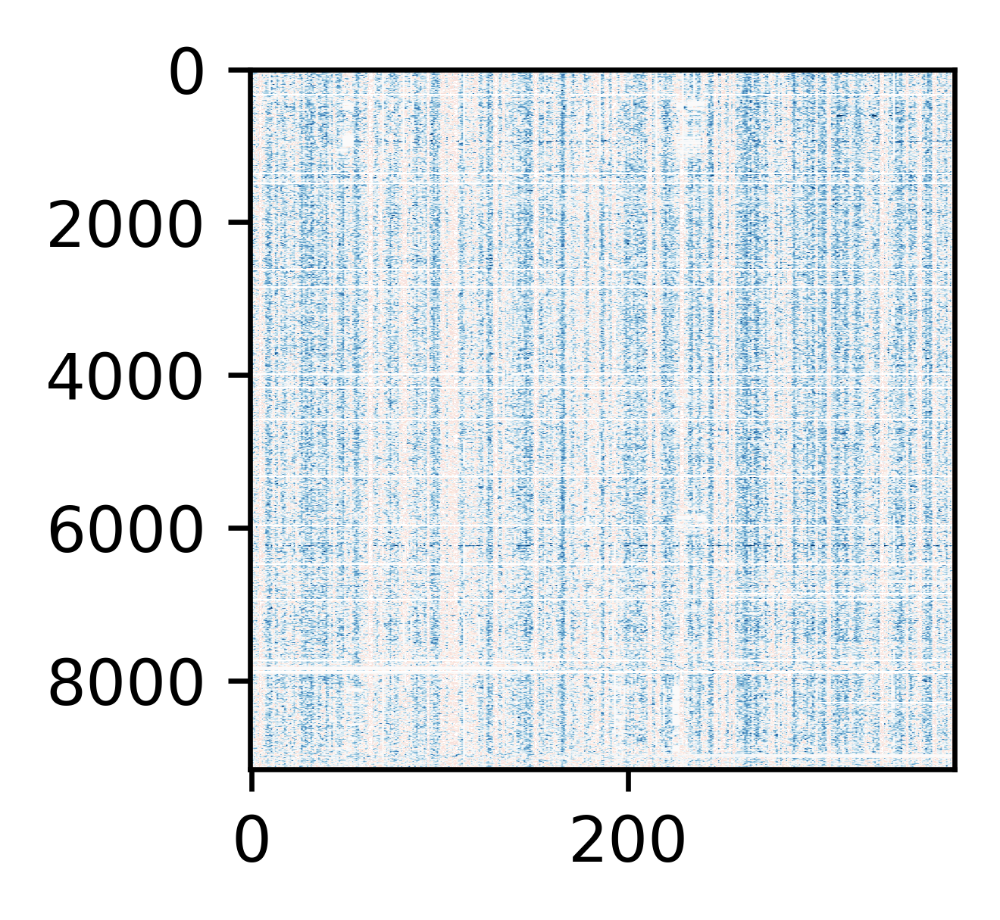

In [15]:
plot_heatmap(phylop, cmap='RdBu', image_res=600, vmax=0.5,vmin=-0.5,figsize=[2,2])

RdBu


AttributeError: AxesImage.set() got an unexpected keyword argument 'interporlation'

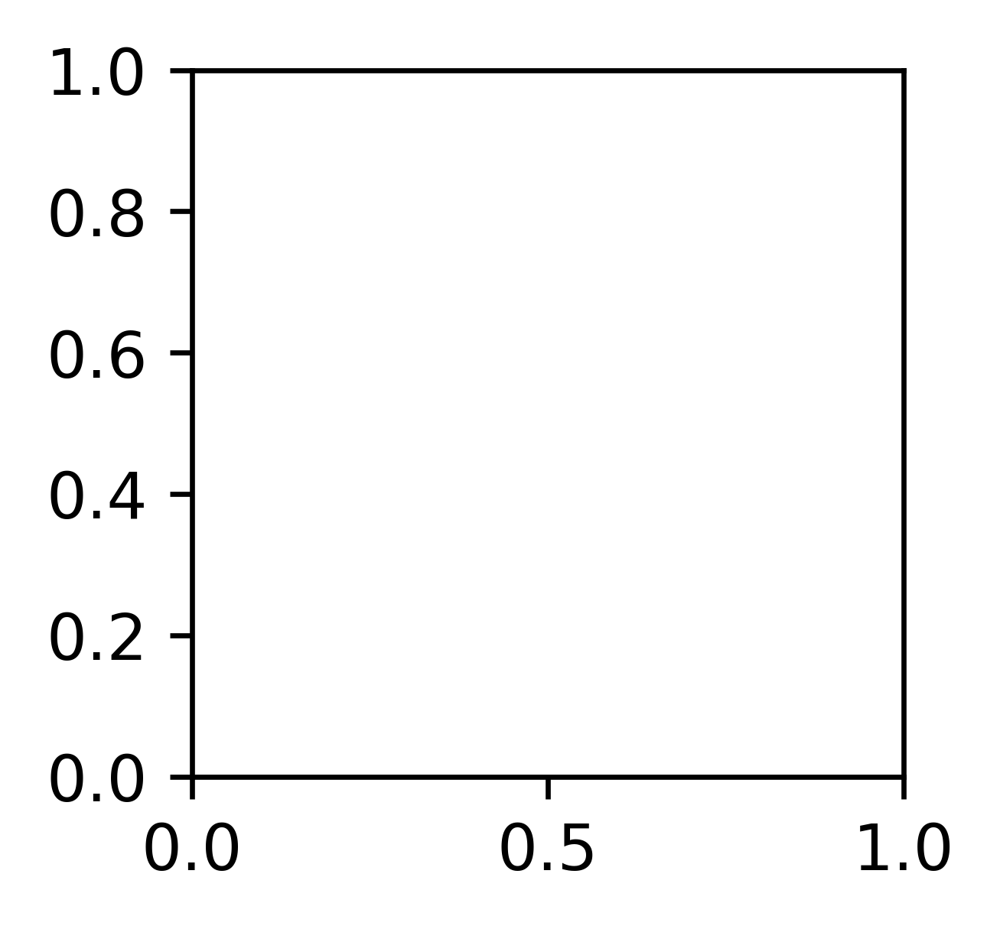

In [16]:
plot_heatmap(phylop, cmap='RdBu', image_res=600, vmax=0.5,vmin=-0.5,figsize=[2,2], interporlation = 'nearest')

RdBu


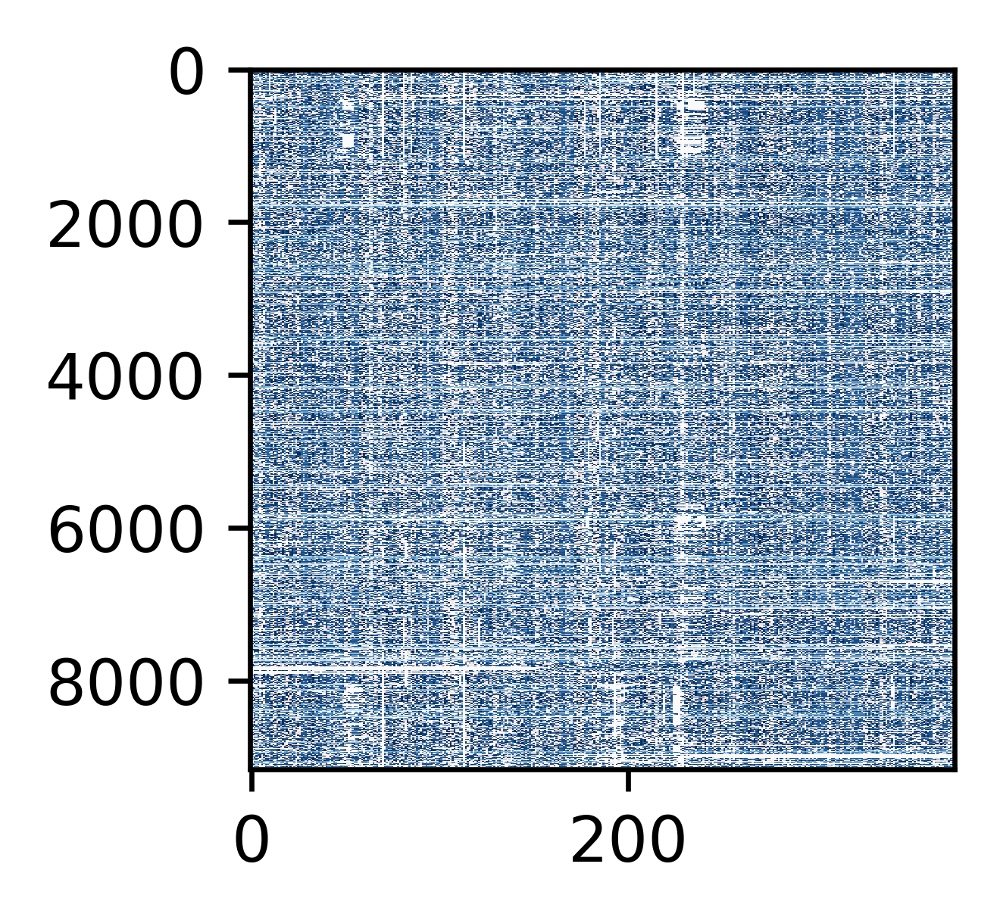

In [17]:
plot_heatmap(phylop, cmap='RdBu', image_res=600, vmax=0.5,vmin=-0.5,figsize=[2,2], interpolation = 'nearest')

RdBu


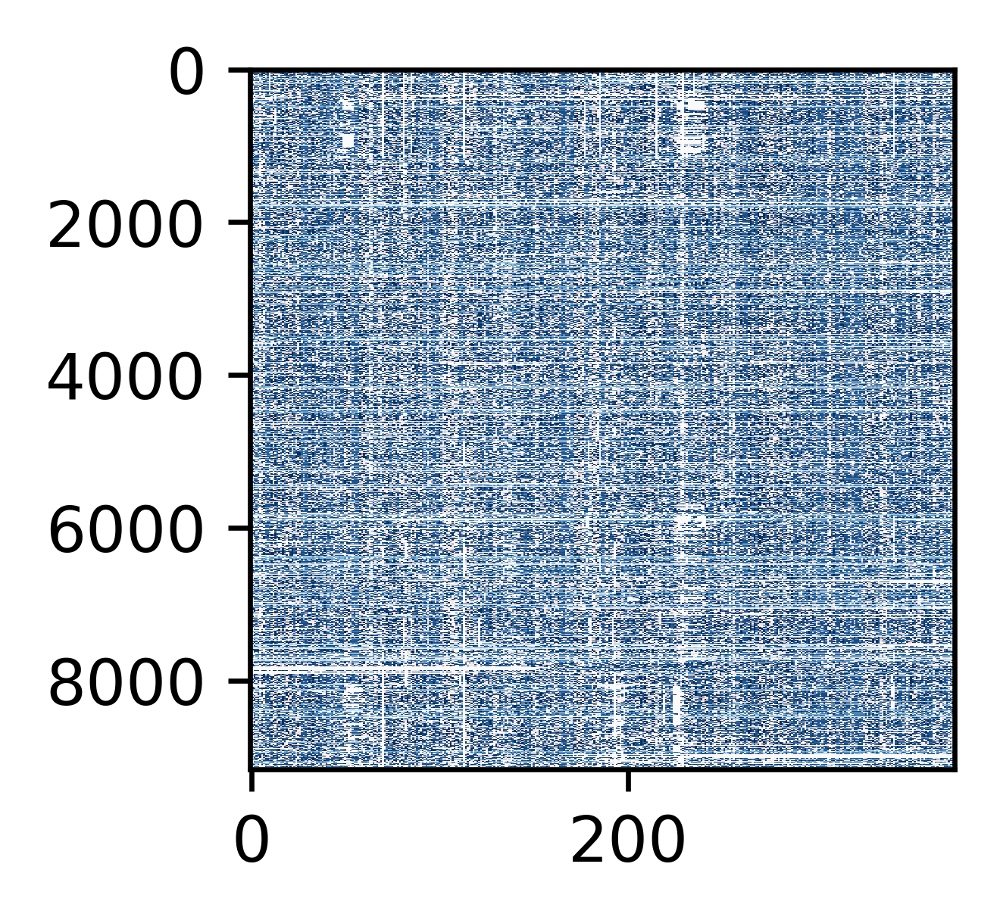

In [18]:
plot_heatmap(phylop, cmap='RdBu', image_res=600, vmax=0.5,vmin=-0.5,figsize=[2,2], interpolation = 'nearest')

RdBu


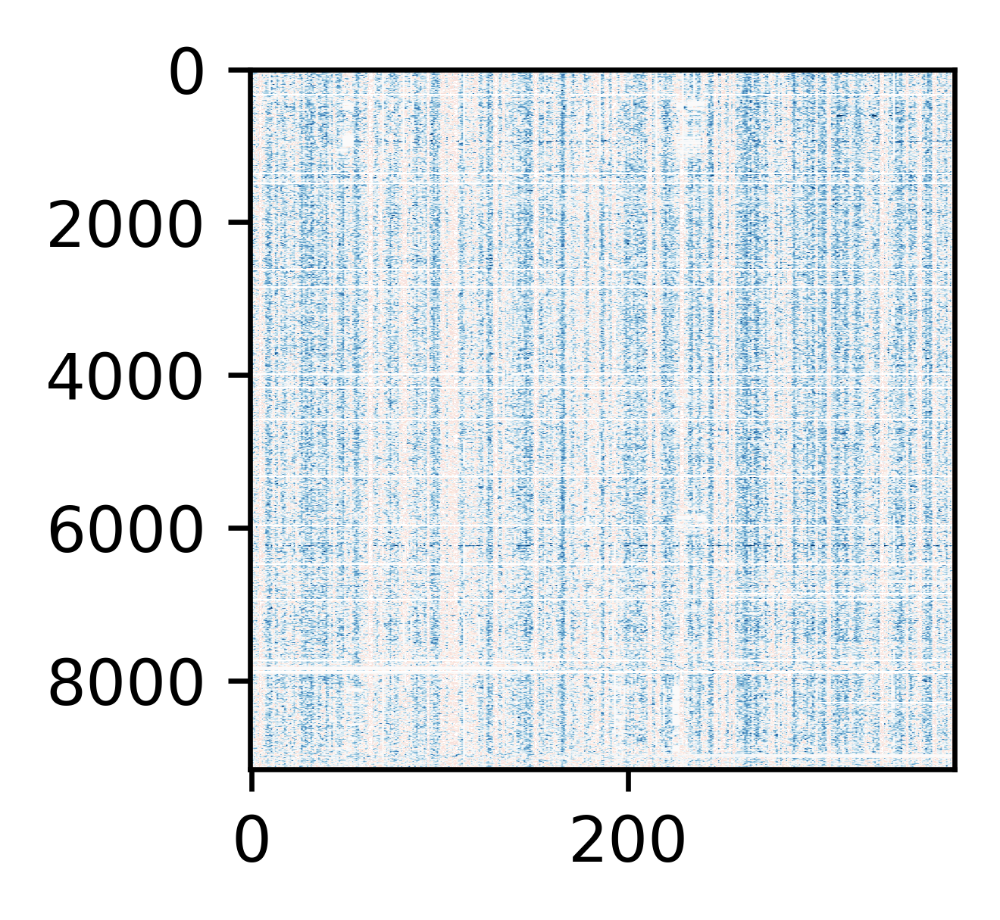

In [19]:
plot_heatmap(phylop, cmap='RdBu', image_res=600, vmax=0.5,vmin=-0.5,figsize=[2,2])

RdBu


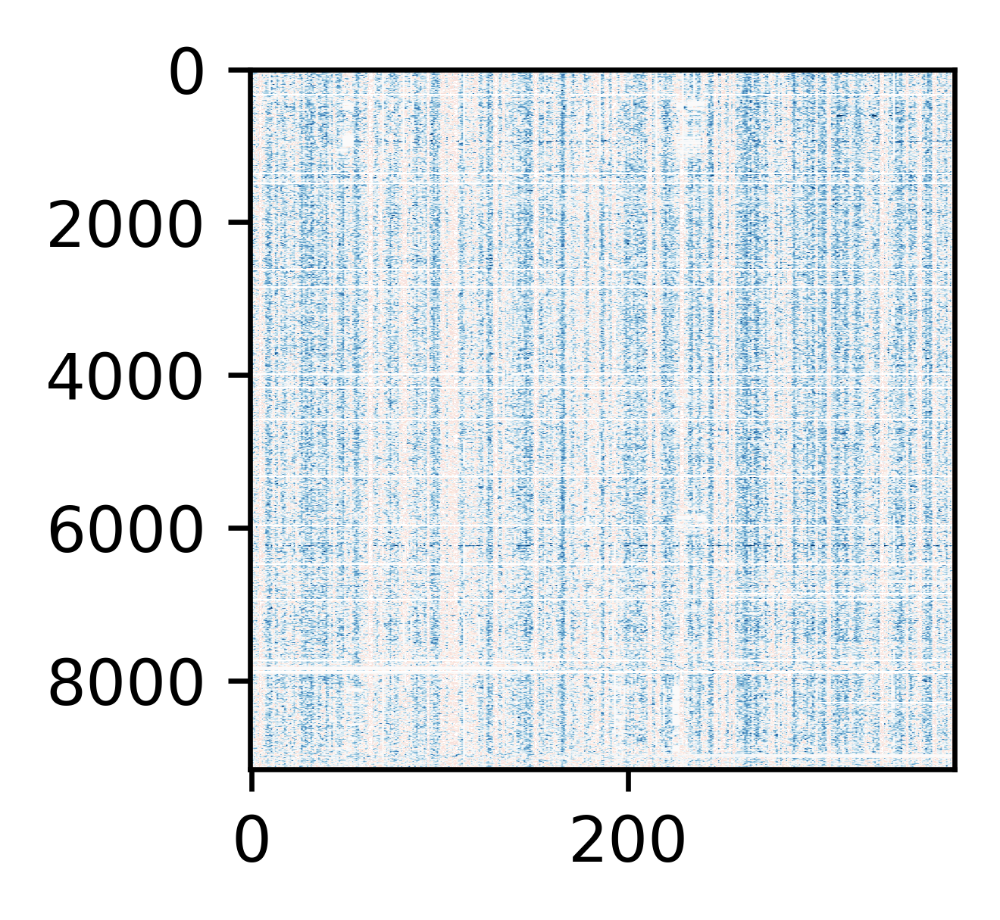

In [20]:
plot_heatmap(phylop, cmap='RdBu', image_res=600, vmax=0.5,vmin=-0.5,figsize=[2,2])

In [21]:
import seaborn as sns

# Get the 'vlag' colormap
cmap = sns.color_palette('vlag', as_cmap=True)

# Get the RGB values of 256 points in the colormap
rgb_values = cmap(np.linspace(0, 1, 256))

# Print the RGB values
for rgb in rgb_values:
    print(rgb)

[0.13850039 0.41331206 0.74052025 1.        ]
[0.15077609 0.41762684 0.73970427 1.        ]
[0.16235219 0.4219191  0.7389667  1.        ]
[0.1733322  0.42619024 0.73832537 1.        ]
[0.18382538 0.43044226 0.73776764 1.        ]
[0.19394034 0.4346772  0.73725867 1.        ]
[0.20367115 0.43889576 0.73685314 1.        ]
[0.21313625 0.44310003 0.73648045 1.        ]
[0.22231173 0.44729079 0.73619681 1.        ]
[0.23125148 0.45146945 0.73597803 1.        ]
[0.23998101 0.45563715 0.7358223  1.        ]
[0.24853358 0.45979489 0.73571524 1.        ]
[0.25691416 0.4639437  0.73566943 1.        ]
[0.26513894 0.46808455 0.73568319 1.        ]
[0.27322194 0.47221835 0.73575497 1.        ]
[0.28117543 0.47634598 0.73588332 1.        ]
[0.28901021 0.48046826 0.73606686 1.        ]
[0.2967358  0.48458597 0.73630433 1.        ]
[0.30436071 0.48869986 0.73659451 1.        ]
[0.3118955  0.49281055 0.73693255 1.        ]
[0.31935389 0.49691847 0.73730851 1.        ]
[0.32672701 0.5010247  0.73774013 

In [22]:
cdict = {'red': [], 'green': [], 'blue': []}
for i, rgb in enumerate(rgb_values):
    red, green, blue = rgb
    cdict['red'].append((i/256, red, red))
    cdict['green'].append((i/256, green, green))
    cdict['blue'].append((i/256, blue, blue))

ValueError: too many values to unpack (expected 3)

In [ ]:
cdict = {'red': [], 'green': [], 'blue': []}
for i, rgb in enumerate(rgb_values):
    red, green, blue = rgb
    cdict['red'].append((i/256, red, red))
    cdict['green'].append((i/256, green, green))
    cdict['blue'].append((i/256, blue, blue))

: 

In [23]:
cdict = {'red': [], 'green': [], 'blue': []}
for i, rgb in enumerate(rgb_values):
    red, green, blue, alpha = rgb
    cdict['red'].append((i/256, red, red))
    cdict['green'].append((i/256, green, green))
    cdict['blue'].append((i/256, blue, blue))

In [24]:
cdict = {'red': [], 'green': [], 'blue': []}
for i, rgb in enumerate(rgb_values):
    red, green, blue, alpha = rgb
    cdict['red'].append((i/256, red, red))
    cdict['green'].append((i/256, green, green))
    cdict['blue'].append((i/256, blue, blue))

In [25]:
cdict

{'red': [(0.0, 0.13850039, 0.13850039),
  (0.00390625, 0.15077609, 0.15077609),
  (0.0078125, 0.16235219, 0.16235219),
  (0.01171875, 0.1733322, 0.1733322),
  (0.015625, 0.18382538, 0.18382538),
  (0.01953125, 0.19394034, 0.19394034),
  (0.0234375, 0.20367115, 0.20367115),
  (0.02734375, 0.21313625, 0.21313625),
  (0.03125, 0.22231173, 0.22231173),
  (0.03515625, 0.23125148, 0.23125148),
  (0.0390625, 0.23998101, 0.23998101),
  (0.04296875, 0.24853358, 0.24853358),
  (0.046875, 0.25691416, 0.25691416),
  (0.05078125, 0.26513894, 0.26513894),
  (0.0546875, 0.27322194, 0.27322194),
  (0.05859375, 0.28117543, 0.28117543),
  (0.0625, 0.28901021, 0.28901021),
  (0.06640625, 0.2967358, 0.2967358),
  (0.0703125, 0.30436071, 0.30436071),
  (0.07421875, 0.3118955, 0.3118955),
  (0.078125, 0.31935389, 0.31935389),
  (0.08203125, 0.32672701, 0.32672701),
  (0.0859375, 0.33402607, 0.33402607),
  (0.08984375, 0.34125337, 0.34125337),
  (0.09375, 0.34840921, 0.34840921),
  (0.09765625, 0.35551826, 0

In [26]:
import seaborn as sns

# Get the 'vlag' colormap
cmap = sns.color_palette('vlag_r', as_cmap=True)

# Get the RGB values of 256 points in the colormap
rgb_values = cmap(np.linspace(0, 1, 256))

# Print the RGB values
#for rgb in rgb_values:
#    print(rgb)

In [27]:
import seaborn as sns

# Get the 'vlag' colormap
cmap = sns.color_palette('vlag_r', as_cmap=True)

# Get the RGB values of 256 points in the colormap
rgb_values = cmap(np.linspace(0, 1, 256))

# Print the RGB values
#for rgb in rgb_values:
#    print(rgb)

In [28]:
import seaborn as sns

# Get the 'vlag' colormap
cmap = sns.color_palette('vlag_r', as_cmap=True)

# Get the RGB values of 256 points in the colormap
rgb_values = cmap(np.linspace(0, 1, 256))

# Print the RGB values
#for rgb in rgb_values:
#    print(rgb)

In [29]:
cdict = {'red': [], 'green': [], 'blue': []}
for i, rgb in enumerate(rgb_values):
    red, green, blue, alpha = rgb
    cdict['red'].append((i/256, red, red))
    cdict['green'].append((i/256, green, green))
    cdict['blue'].append((i/256, blue, blue))

In [30]:
cdict

{'red': [(0.0, 0.66080672, 0.66080672),
  (0.00390625, 0.6638441, 0.6638441),
  (0.0078125, 0.66693423, 0.66693423),
  (0.01171875, 0.67000176, 0.67000176),
  (0.015625, 0.67305921, 0.67305921),
  (0.01953125, 0.67609393, 0.67609393),
  (0.0234375, 0.67911013, 0.67911013),
  (0.02734375, 0.682108, 0.682108),
  (0.03125, 0.6850794, 0.6850794),
  (0.03515625, 0.68803513, 0.68803513),
  (0.0390625, 0.69097561, 0.69097561),
  (0.04296875, 0.69388446, 0.69388446),
  (0.046875, 0.6967754, 0.6967754),
  (0.05078125, 0.69965211, 0.69965211),
  (0.0546875, 0.70250944, 0.70250944),
  (0.05859375, 0.70534784, 0.70534784),
  (0.0625, 0.70816772, 0.70816772),
  (0.06640625, 0.71096951, 0.71096951),
  (0.0703125, 0.71375362, 0.71375362),
  (0.07421875, 0.71652049, 0.71652049),
  (0.078125, 0.71927052, 0.71927052),
  (0.08203125, 0.72200473, 0.72200473),
  (0.0859375, 0.72472722, 0.72472722),
  (0.08984375, 0.72743485, 0.72743485),
  (0.09375, 0.73011829, 0.73011829),
  (0.09765625, 0.73278943, 0.732